In [2]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split


import plotly.express as px
import plotly.graph_objects as go

from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier



from sklearn.metrics import accuracy_score, roc_auc_score

from sklearn.metrics import confusion_matrix, classification_report

import pickle

import datetime

# ggplot style sheet
plt.style.use('ggplot')







#### The below column reference:

• step: represents a unit of time where 1 step equals 1
hour

• type: type of online transaction

• amount: the amount of the transaction

• nameOrig: customer starting the transaction

• oldbalanceOrg: balance before the transaction

• newbalanceOrig: balance after the transaction

• nameDest: recipient of the transaction

• oldbalanceDest: initial balance of recipient
before the transaction

• newbalanceDest: the new balance of the
recipient after the transaction

• isFraud: fraud transaction

In [3]:
# import the dataset
df = pd.read_csv(r"C:\Users\DELL\Downloads\Online Payment Fraud Detection.csv")
df

,step,type,amount,nameOrig,oldbalanceOrg,newbalanceOrig,nameDest,oldbalanceDest,newbalanceDest,isFraud
0,1,PAYMENT,9839.64,C1231006815,170136.00,160296.36,M1979787155,0.00,0.00,0
1,1,PAYMENT,1864.28,C1666544295,21249.00,19384.72,M2044282225,0.00,0.00,0
2,1,TRANSFER,181.00,C1305486145,181.00,0.00,C553264065,0.00,0.00,1
3,1,CASH_OUT,181.00,C840083671,181.00,0.00,C38997010,21182.00,0.00,1
4,1,PAYMENT,11668.14,C2048537720,41554.00,29885.86,M1230701703,0.00,0.00,0
...,...,...,...,...,...,...,...,...,...,...
1048570,95,CASH_OUT,132557.35,C1179511630,479803.00,347245.65,C435674507,484329.37,616886.72,0
1048571,95,PAYMENT,9917.36,C1956161225,90545.00,80627.64,M668364942,0.00,0.00,0
1048572,95,PAYMENT,14140.05,C2037964975,20545.00,6404.95,M1355182933,0.00,0.00,0
1048573,95,PAYMENT,10020.05,C1633237354,90605.00,80584.95,M1964992463,0.00,0.00,0


In [4]:
# shape of the data
df.shape

(1048575, 10)

In [5]:
# dataset information
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1048575 entries, 0 to 1048574
Data columns (total 10 columns):
 #   Column          Non-Null Count    Dtype  
---  ------          --------------    -----  
 0   step            1048575 non-null  int64  
 1   type            1048575 non-null  object 
 2   amount          1048575 non-null  float64
 3   nameOrig        1048575 non-null  object 
 4   oldbalanceOrg   1048575 non-null  float64
 5   newbalanceOrig  1048575 non-null  float64
 6   nameDest        1048575 non-null  object 
 7   oldbalanceDest  1048575 non-null  float64
 8   newbalanceDest  1048575 non-null  float64
 9   isFraud         1048575 non-null  int64  
dtypes: float64(5), int64(2), object(3)
memory usage: 80.0+ MB


In [6]:
# descriptive statistivs of the dataset
df.describe()

,step,amount,oldbalanceOrg,newbalanceOrig,oldbalanceDest,newbalanceDest,isFraud
count,1.048575e+06,1.048575e+06,1.048575e+06,1.048575e+06,1.048575e+06,1.048575e+06,1.048575e+06
mean,2.696617e+01,1.586670e+05,8.740095e+05,8.938089e+05,9.781600e+05,1.114198e+06,1.089097e-03
std,1.562325e+01,2.649409e+05,2.971751e+06,3.008271e+06,2.296780e+06,2.416593e+06,3.298351e-02
min,1.000000e+00,1.000000e-01,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
25%,1.500000e+01,1.214907e+04,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
50%,2.000000e+01,7.634333e+04,1.600200e+04,0.000000e+00,1.263772e+05,2.182604e+05,0.000000e+00
75%,3.900000e+01,2.137619e+05,1.366420e+05,1.746000e+05,9.159235e+05,1.149808e+06,0.000000e+00
max,9.500000e+01,1.000000e+07,3.890000e+07,3.890000e+07,4.210000e+07,4.220000e+07,1.000000e+00


In [7]:
# checking for missing vales if they exist
df.isnull().sum()

step              0
type              0
amount            0
nameOrig          0
oldbalanceOrg     0
newbalanceOrig    0
nameDest          0
oldbalanceDest    0
newbalanceDest    0
isFraud           0
dtype: int64

In [8]:
df.dtypes

step                int64
type               object
amount            float64
nameOrig           object
oldbalanceOrg     float64
newbalanceOrig    float64
nameDest           object
oldbalanceDest    float64
newbalanceDest    float64
isFraud             int64
dtype: object

In [9]:
df['isFraud'].unique()

array([0, 1], dtype=int64)

step               17974
amount             53088
oldbalanceOrg     181877
newbalanceOrig    170244
oldbalanceDest    125403
newbalanceDest    114557
isFraud             1142
dtype: int64


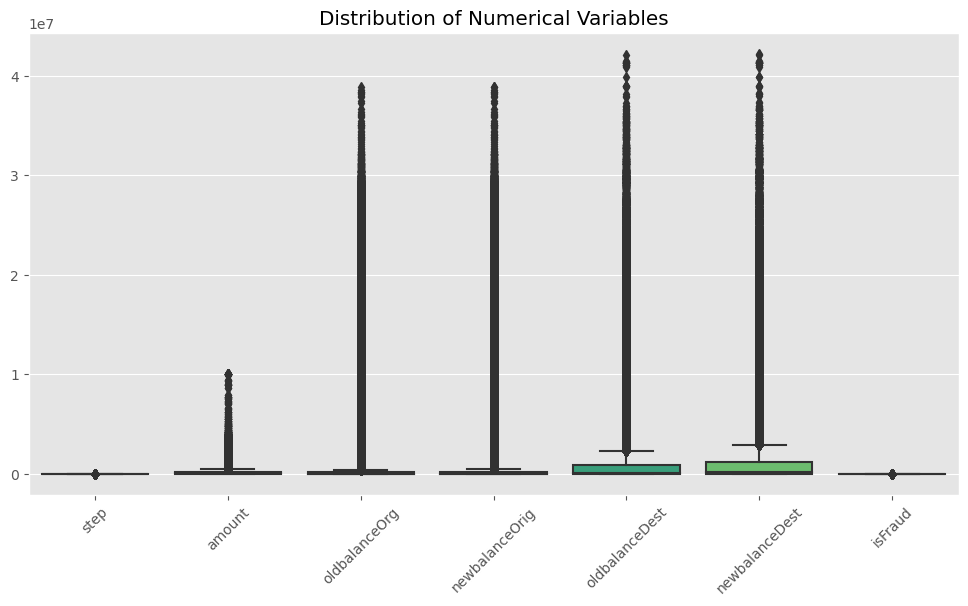

In [10]:
# Handling outliers (if any)
# You can use techniques like z-score, IQR, or domain knowledge-based methods to detect and remove outliers

# Extract the numerical columns from the dataset
num_vars = df.select_dtypes(include=['int64', 'float64'])

# Calculate the number of outliers for each numerical variable
outliers_count = ((num_vars < num_vars.quantile(0.25) - 1.5 * (num_vars.quantile(0.75) - num_vars.quantile(0.25))) |
                  (num_vars > num_vars.quantile(0.75) + 1.5 * (num_vars.quantile(0.75) - num_vars.quantile(0.25))))
outliers_count = outliers_count.sum()

# Display the number of outliers in a table
print(outliers_count)

# Create a boxplot to show the distribution of each numerical variable
plt.figure(figsize=(12, 6))
sns.boxplot(data=num_vars, palette='viridis')
plt.title('Distribution of Numerical Variables')
plt.xticks(rotation=45)
plt.show()

In [11]:
# Handle outliers, if they exist
from scipy import stats

# Define a threshold for z-score
z_threshold = 3

# Calculate z-scores for each numerical feature
z_scores = stats.zscore(df.select_dtypes(include='number'))

# Identify outliers
outliers = (z_scores > z_threshold).any(axis=1)

# Remove outliers
df1 = df[~outliers]

df1

,step,type,amount,nameOrig,oldbalanceOrg,newbalanceOrig,nameDest,oldbalanceDest,newbalanceDest,isFraud
0,1,PAYMENT,9839.64,C1231006815,170136.00,160296.36,M1979787155,0.00,0.00,0
1,1,PAYMENT,1864.28,C1666544295,21249.00,19384.72,M2044282225,0.00,0.00,0
4,1,PAYMENT,11668.14,C2048537720,41554.00,29885.86,M1230701703,0.00,0.00,0
5,1,PAYMENT,7817.71,C90045638,53860.00,46042.29,M573487274,0.00,0.00,0
6,1,PAYMENT,7107.77,C154988899,183195.00,176087.23,M408069119,0.00,0.00,0
...,...,...,...,...,...,...,...,...,...,...
1030252,49,PAYMENT,689.13,C241393103,180594.19,179905.07,M1168811638,0.00,0.00,0
1030253,49,PAYMENT,1029.02,C645820813,106745.00,105715.98,M31907590,0.00,0.00,0
1030254,49,PAYMENT,3610.13,C369063888,251.00,0.00,M100067855,0.00,0.00,0
1030255,49,CASH_OUT,24946.52,C1347485989,0.00,0.00,C958314752,340924.92,365871.43,0


In [12]:
# Calculate the median of each numerical variable
medians = num_vars.median()

# Replace outliers with the median of each variable
for column in num_vars.columns:
    q1 = num_vars[column].quantile(0.25)
    q3 = num_vars[column].quantile(0.75)
    iqr = q3 - q1
    lower_bound = q1 - 1.5 * iqr
    upper_bound = q3 + 1.5 * iqr
    num_vars[column] = num_vars[column].apply(lambda x: medians[column] if x < lower_bound or x > upper_bound else x)

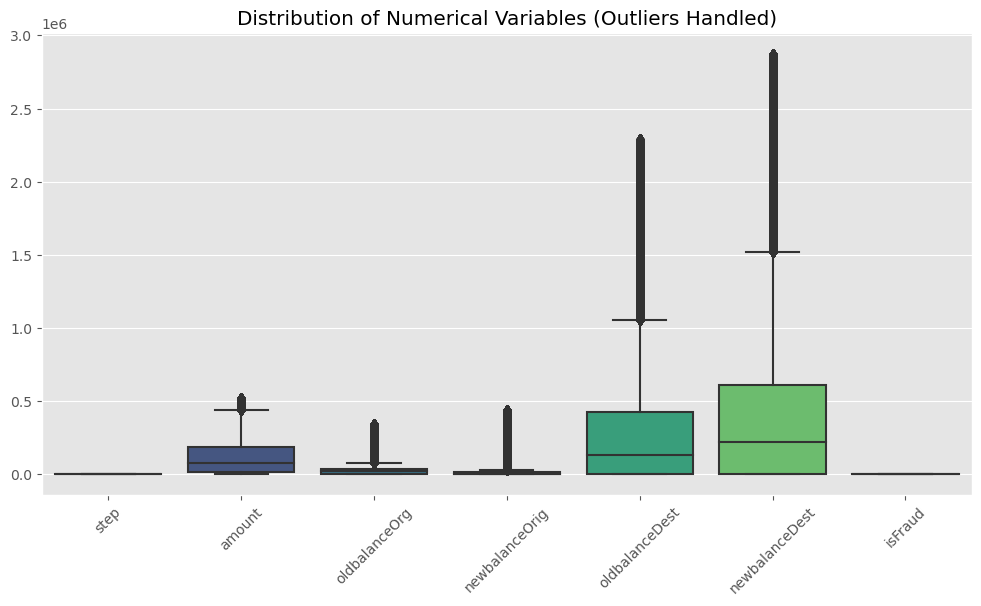

In [13]:
# Create a boxplot to show the distribution of each numerical variable after handling outliers
plt.figure(figsize=(12, 6))
sns.boxplot(data=num_vars, palette='viridis')
plt.title('Distribution of Numerical Variables (Outliers Handled)')
plt.xticks(rotation=45)
plt.show()

In [14]:
df1.head()

,step,type,amount,nameOrig,oldbalanceOrg,newbalanceOrig,nameDest,oldbalanceDest,newbalanceDest,isFraud
0,1,PAYMENT,9839.64,C1231006815,170136.0,160296.36,M1979787155,0.0,0.0,0
1,1,PAYMENT,1864.28,C1666544295,21249.0,19384.72,M2044282225,0.0,0.0,0
4,1,PAYMENT,11668.14,C2048537720,41554.0,29885.86,M1230701703,0.0,0.0,0
5,1,PAYMENT,7817.71,C90045638,53860.0,46042.29,M573487274,0.0,0.0,0
6,1,PAYMENT,7107.77,C154988899,183195.0,176087.23,M408069119,0.0,0.0,0


In [15]:
df1.type.value_counts()

type
CASH_OUT    357251
PAYMENT     345300
CASH_IN     191493
TRANSFER     63183
DEBIT         6798
Name: count, dtype: int64

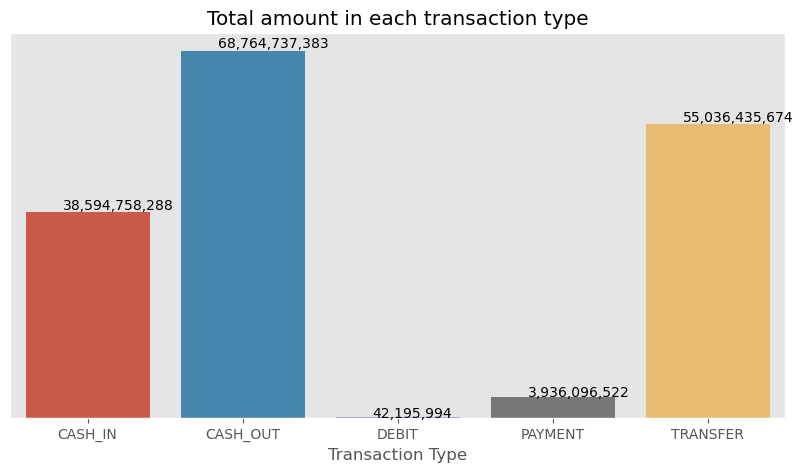

In [16]:
d = df.groupby('type')['amount'].sum()
plt.figure(figsize=(10,5))
ax = sns.barplot(x=d.index,y=d.values)
for p in ax.patches:
    ax.annotate(str(format(int(p.get_height()), ',d')), (p.get_x()+0.24, p.get_height()*1.01))

plt.title("Total amount in each transaction type")
plt.yticks([])
plt.xlabel("Transaction Type")
plt.show()

# Data Validation

In [17]:
# select the numerical variables
print(num_vars)

# value counts for numerical variables
for column in num_vars:
    print(df[column].value_counts())

         step     amount  oldbalanceOrg  newbalanceOrig  oldbalanceDest  \
0         1.0    9839.64      170136.00       160296.36            0.00   
1         1.0    1864.28       21249.00        19384.72            0.00   
2         1.0     181.00         181.00            0.00            0.00   
3         1.0     181.00         181.00            0.00        21182.00   
4         1.0   11668.14       41554.00        29885.86            0.00   
...       ...        ...            ...             ...             ...   
1048570  20.0  132557.35       16002.00       347245.65       484329.37   
1048571  20.0    9917.36       90545.00        80627.64            0.00   
1048572  20.0   14140.05       20545.00         6404.95            0.00   
1048573  20.0   10020.05       90605.00        80584.95            0.00   
1048574  20.0   11450.03       80584.95        69134.92            0.00   

         newbalanceDest  isFraud  
0                  0.00      0.0  
1                  0.00      

In [18]:
# select the categorical variables
cat_vars = df.select_dtypes(include=['category', 'object'])
print(cat_vars)

# value counts for categorical variables
for column in cat_vars:
    print(df[column].value_counts())

             type     nameOrig     nameDest
0         PAYMENT  C1231006815  M1979787155
1         PAYMENT  C1666544295  M2044282225
2        TRANSFER  C1305486145   C553264065
3        CASH_OUT   C840083671    C38997010
4         PAYMENT  C2048537720  M1230701703
...           ...          ...          ...
1048570  CASH_OUT  C1179511630   C435674507
1048571   PAYMENT  C1956161225   M668364942
1048572   PAYMENT  C2037964975  M1355182933
1048573   PAYMENT  C1633237354  M1964992463
1048574   PAYMENT  C1264356443   M677577406

[1048575 rows x 3 columns]
type
CASH_OUT    373641
PAYMENT     353873
CASH_IN     227130
TRANSFER     86753
DEBIT         7178
Name: count, dtype: int64
nameOrig
C1214450722    2
C309111136     2
C1268675361    2
C720460198     2
C1109092856    2
              ..
C560131732     1
C455251560     1
C650578540     1
C1883668225    1
C1264356443    1
Name: count, Length: 1048317, dtype: int64
nameDest
C985934102     98
C1286084959    96
C1590550415    89
C248609774     8

## Exploratory Data Analysis
- Univariate Analysis
- Bivariate Analysis
- Multivariate Analysis

#### Univariate analysis

what is the proportion of the fraud detection

In [19]:
labels = list(df['isFraud'].value_counts().index)
values = list(df['isFraud'].value_counts().values)

fig = go.Figure(data=[go.Pie(labels=labels, values=values)])
fig.show()

##### observation

we have no fraudulent cases after treating the otlier

In [20]:
labels = list(df['type'].value_counts().index)
values = list(df['type'].value_counts().values)

fig = go.Figure(data=[go.Bar(x=labels, y=values)])
fig.update_layout(
    title='Transaction Type Counts',
    xaxis_title='Transaction Type',
    yaxis_title='Count',
    bargap=0.1
)
fig.show()

##### observation

CASH-OUT has the highest transaction

#### Amount Distribution

In [21]:
fig = px.box(df1, x = 'amount')
fig.show()

### Bivariate Analysis

In [22]:
df.columns.tolist()

['step',
 'type',
 'amount',
 'nameOrig',
 'oldbalanceOrg',
 'newbalanceOrig',
 'nameDest',
 'oldbalanceDest',
 'newbalanceDest',
 'isFraud']

In [23]:
# type and fraud
type_fraud = df.groupby('type')['isFraud'].sum().sort_values(ascending = False)
type_fraud 

type
CASH_OUT    578
TRANSFER    564
CASH_IN       0
DEBIT         0
PAYMENT       0
Name: isFraud, dtype: int64

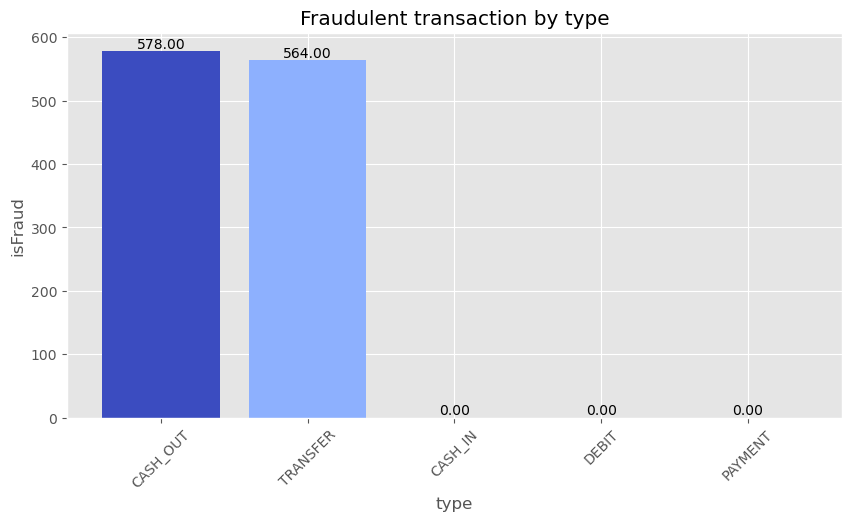

In [24]:
# Group by type and calculate the sum of fraud for each fraudulent
type_fraud  = df.groupby('type')['isFraud'].sum().sort_values(ascending=False)

# Create a color gradient for the bars
colors = plt.cm.coolwarm(np.linspace(0, 1, len(type_fraud )))

# Create the bar chart
plt.figure(figsize=(10, 5))
bars = plt.bar(type_fraud.index, type_fraud .values, color=colors)

# Add data labels to the bars
for bar in bars:
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width() / 2, height,
             f'{height:.2f}', ha='center', va='bottom')

# Customize the chart
plt.xticks(rotation=45)
plt.xlabel('type')
plt.ylabel('isFraud')
plt.title('Fraudulent transaction by type')

# Show the plot
plt.show()


**Some key insights gather from this data:**

- The two transaction types with the highest number of fraudulent transactions are CASH_OUT and TRANSFER.

- The other transaction types (CASH_IN, DEBIT, and PAYMENT) do not have any fraudulent transactions in this dataset.

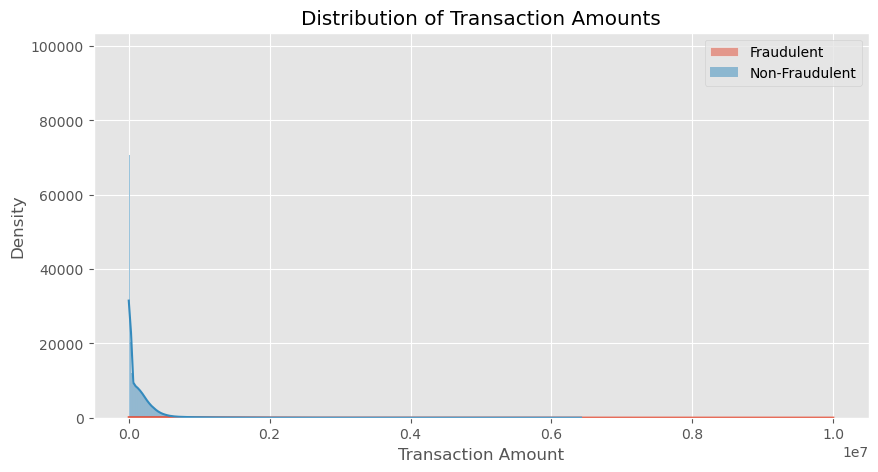

In [25]:
# Subset the DataFrame to only include the CASH_OUT and TRANSFER transactions
fraud_transactions = df[df['type'].isin(['CASH_OUT', 'TRANSFER']) & df['isFraud'] == 1]
non_fraud_transactions = df[df['type'].isin(['CASH_OUT', 'TRANSFER']) & df['isFraud'] == 0]


plt.figure(figsize=(10, 5))
sns.histplot(fraud_transactions['amount'], kde=True, label='Fraudulent')
sns.histplot(non_fraud_transactions['amount'], kde=True, label='Non-Fraudulent')
plt.xlabel('Transaction Amount')
plt.ylabel('Density')
plt.title('Distribution of Transaction Amounts')
plt.legend()
plt.show()

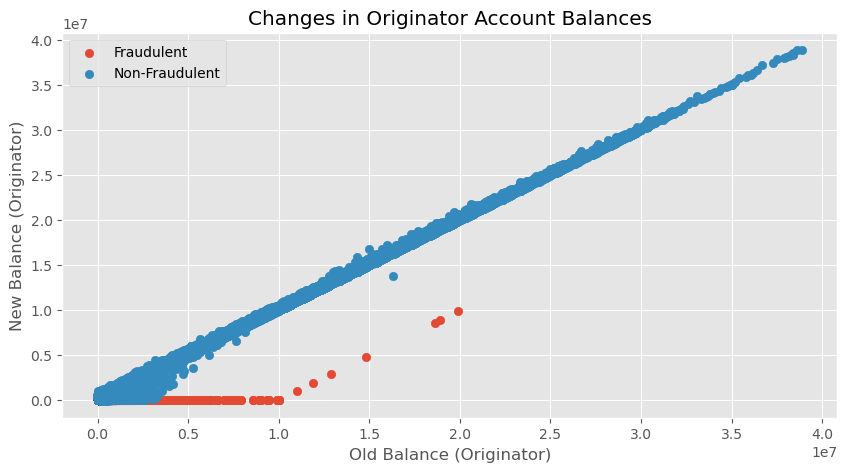

In [26]:
# Analyze Account Balances
plt.figure(figsize=(10, 5))
plt.scatter(fraud_transactions['oldbalanceOrg'], fraud_transactions['newbalanceOrig'], label='Fraudulent')
plt.scatter(non_fraud_transactions['oldbalanceOrg'], non_fraud_transactions['newbalanceOrig'], label='Non-Fraudulent')
plt.xlabel('Old Balance (Originator)')
plt.ylabel('New Balance (Originator)')
plt.title('Changes in Originator Account Balances')
plt.legend()
plt.show()

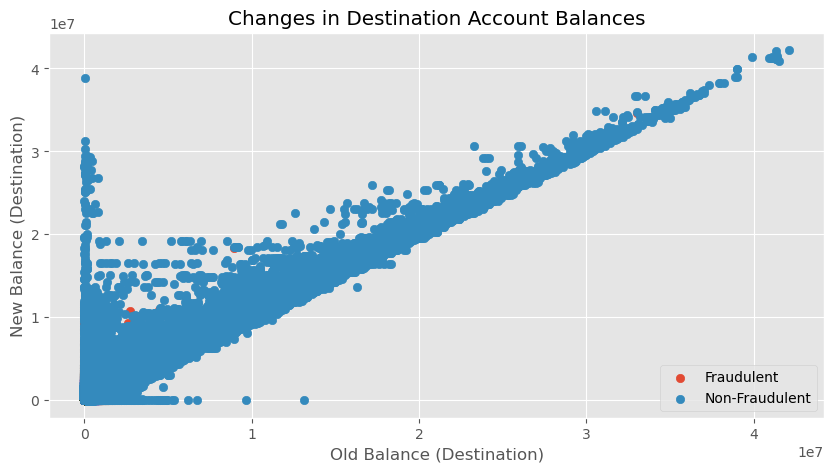

In [27]:
plt.figure(figsize=(10, 5))
plt.scatter(fraud_transactions['oldbalanceDest'], fraud_transactions['newbalanceDest'], label='Fraudulent')
plt.scatter(non_fraud_transactions['oldbalanceDest'], non_fraud_transactions['newbalanceDest'], label='Non-Fraudulent')
plt.xlabel('Old Balance (Destination)')
plt.ylabel('New Balance (Destination)')
plt.title('Changes in Destination Account Balances')
plt.legend()
plt.show()

### Multivariate Analysis

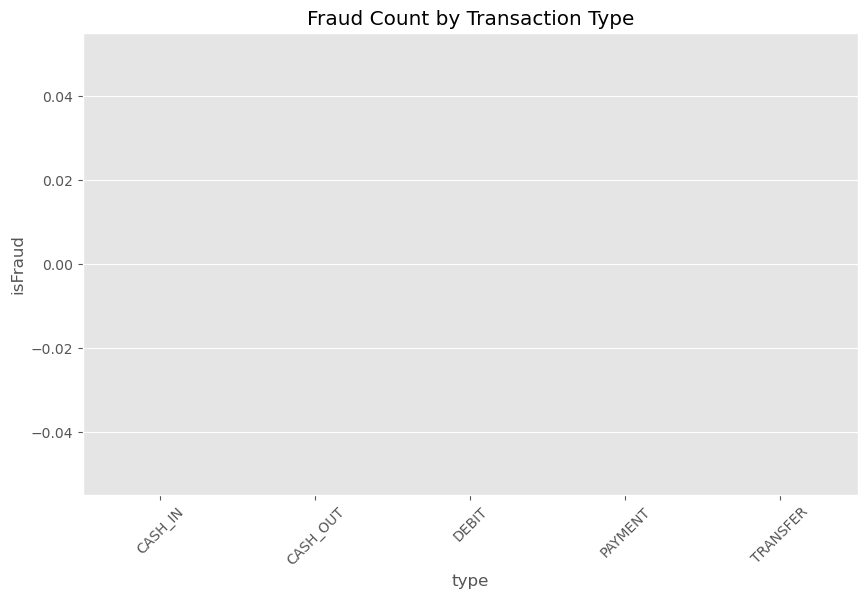

Chi-Square Statistic: 0.00
p-value: 1.0000


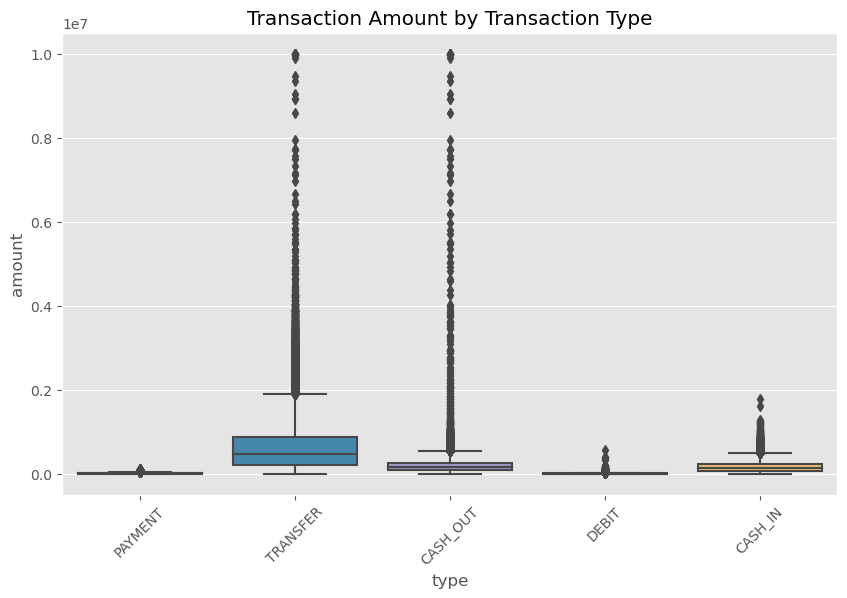

ANOVA F-statistic: 173849.27
p-value: 0.0000


C:\Users\DELL\AppData\Local\Temp\ipykernel_10040\104319453.py:36: UserWarning:

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.



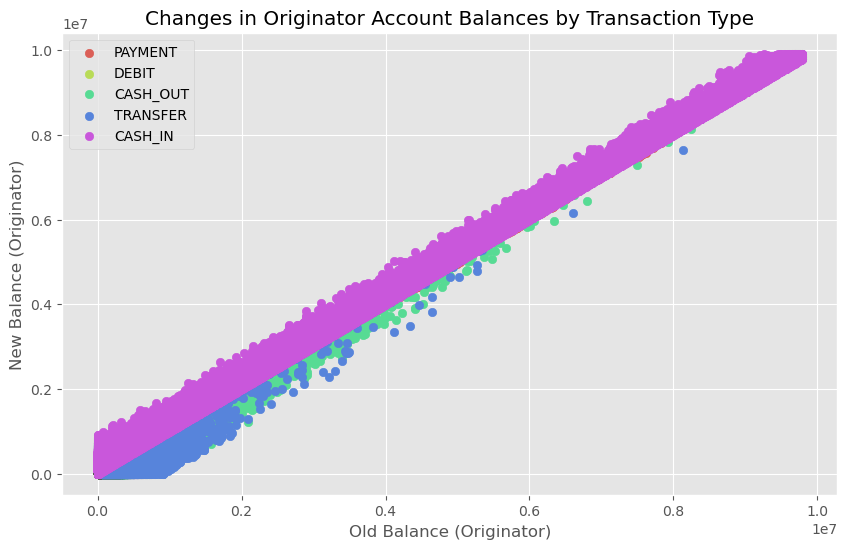

In [28]:

# Transaction Type vs Fraud Status
fraud_by_type = df1.groupby('type')['isFraud'].sum().reset_index()
plt.figure(figsize=(10, 6))
sns.barplot(x='type', y='isFraud', data=fraud_by_type)
plt.title('Fraud Count by Transaction Type')
plt.xticks(rotation=45)
plt.show()

# Perform Chi-Square test
from scipy.stats import chi2_contingency
contingency_table = pd.crosstab(df1['type'], df['isFraud'])
chi2, p_value, dof, expected = chi2_contingency(contingency_table)
print(f'Chi-Square Statistic: {chi2:.2f}')
print(f'p-value: {p_value:.4f}')

# Transaction Type vs Transaction Amount
plt.figure(figsize=(10, 6))
sns.boxplot(x='type', y='amount', data=df)
plt.title('Transaction Amount by Transaction Type')
plt.xticks(rotation=45)
plt.show()

# Perform ANOVA
from scipy.stats import f_oneway
amount_by_type = df1.groupby('type')['amount'].apply(list)
f_statistic, p_value = f_oneway(*amount_by_type.values)
print(f'ANOVA F-statistic: {f_statistic:.2f}')
print(f'p-value: {p_value:.4f}')

unique_types = df1['type'].unique()
type_colors = sns.color_palette("hls", len(unique_types))

plt.figure(figsize=(10, 6))
for i, type in enumerate(unique_types):
    type_data = df1[df1['type'] == type]
    plt.scatter(type_data['oldbalanceOrg'], type_data['newbalanceOrig'], c=type_colors[i], label=type)

plt.title('Changes in Originator Account Balances by Transaction Type')
plt.xlabel('Old Balance (Originator)')
plt.ylabel('New Balance (Originator)')
plt.legend()
plt.show()


In [29]:
df1.head()

,step,type,amount,nameOrig,oldbalanceOrg,newbalanceOrig,nameDest,oldbalanceDest,newbalanceDest,isFraud
0,1,PAYMENT,9839.64,C1231006815,170136.0,160296.36,M1979787155,0.0,0.0,0
1,1,PAYMENT,1864.28,C1666544295,21249.0,19384.72,M2044282225,0.0,0.0,0
4,1,PAYMENT,11668.14,C2048537720,41554.0,29885.86,M1230701703,0.0,0.0,0
5,1,PAYMENT,7817.71,C90045638,53860.0,46042.29,M573487274,0.0,0.0,0
6,1,PAYMENT,7107.77,C154988899,183195.0,176087.23,M408069119,0.0,0.0,0


C:\Users\DELL\anaconda3\ana\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning:

The figure layout has changed to tight



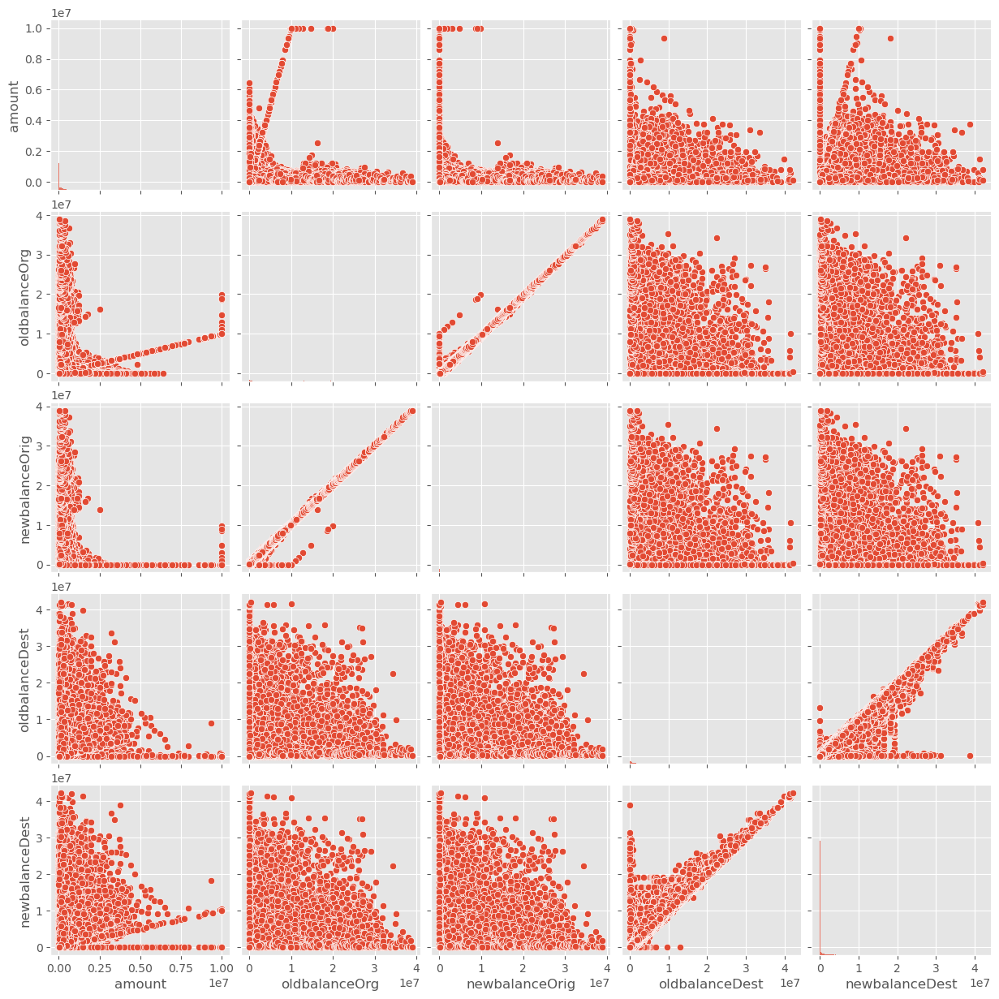

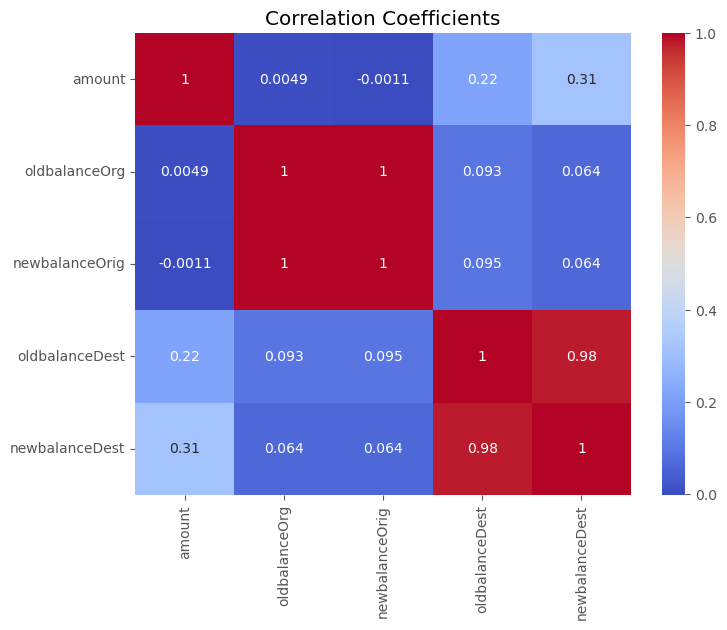

In [30]:
# Select the numerical variables
numerical_vars = ['amount', 'oldbalanceOrg', 'newbalanceOrig', 'oldbalanceDest', 'newbalanceDest']

# Create a scatterplot matrix using Seaborn
sns.pairplot(df[numerical_vars])

# Calculate the correlation coefficients
correlation_matrix = df[numerical_vars].corr()

# Display the correlation matrix
plt.figure(figsize=(8, 6))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm')
plt.title('Correlation Coefficients')
plt.show()

In [31]:
df['isFraud'].value_counts()

isFraud
0    1047433
1       1142
Name: count, dtype: int64

## Feature Selection

In [32]:
# removing unwanted columns
df.drop(['nameOrig', 'nameDest'], axis=1, inplace=True)

In [33]:
from sklearn.preprocessing import LabelEncoder

# Assuming 'df' is your DataFrame
columns_to_encode = ['type']
# Create a label encoder instance
label_encoder = LabelEncoder()

# Apply label encoding to each categorical column
for column in columns_to_encode:
    df[column] = label_encoder.fit_transform(df[column])

# Display the updated DataFrame
print(df.head(20))

    step  type     amount  oldbalanceOrg  newbalanceOrig  oldbalanceDest  \
0      1     3    9839.64      170136.00       160296.36             0.0   
1      1     3    1864.28       21249.00        19384.72             0.0   
2      1     4     181.00         181.00            0.00             0.0   
3      1     1     181.00         181.00            0.00         21182.0   
4      1     3   11668.14       41554.00        29885.86             0.0   
5      1     3    7817.71       53860.00        46042.29             0.0   
6      1     3    7107.77      183195.00       176087.23             0.0   
7      1     3    7861.64      176087.23       168225.59             0.0   
8      1     3    4024.36        2671.00            0.00             0.0   
9      1     2    5337.77       41720.00        36382.23         41898.0   
10     1     2    9644.94        4465.00            0.00         10845.0   
11     1     3    3099.97       20771.00        17671.03             0.0   
12     1    

In [34]:
# Select the target variable y
y = df['isFraud']

# Drop the target variable and create the independent variables
x = df.drop('isFraud', axis=1)

In [35]:
y.head()

0    0
1    0
2    1
3    1
4    0
Name: isFraud, dtype: int64

In [36]:
x.head()

,step,type,amount,oldbalanceOrg,newbalanceOrig,oldbalanceDest,newbalanceDest
0,1,3,9839.64,170136.0,160296.36,0.0,0.0
1,1,3,1864.28,21249.0,19384.72,0.0,0.0
2,1,4,181.00,181.0,0.00,0.0,0.0
3,1,1,181.00,181.0,0.00,21182.0,0.0
4,1,3,11668.14,41554.0,29885.86,0.0,0.0


In [37]:
y.value_counts()

isFraud
0    1047433
1       1142
Name: count, dtype: int64

In [38]:
pip install -U imbalanced-learn

In [39]:
print("df type of x:", x.dtypes)
print("df type of y:", y.dtypes)


df type of x: step                int64
type                int32
amount            float64
oldbalanceOrg     float64
newbalanceOrig    float64
oldbalanceDest    float64
newbalanceDest    float64
dtype: object
df type of y: int64


In [40]:
from imblearn.over_sampling import SMOTE
from collections import Counter

# Instantiate SMOTE
smote = SMOTE(sampling_strategy='auto', random_state=42)

# Resampled the data
x_resampled, y_resampled = smote.fit_resample(x, y)

# Print the class distribution before and after resampling
print('Class distribution before resampling: {}'.format(Counter(y)))
print('Class distribution after resampling: {}'.format(Counter(y_resampled)))

Class distribution before resampling: Counter({0: 1047433, 1: 1142})
Class distribution after resampling: Counter({0: 1047433, 1: 1047433})


In [41]:
from sklearn.model_selection import train_test_split

# Split the data into training and testing sets
x_train, x_test, y_train, y_test = train_test_split(x_resampled, y_resampled, test_size=0.2, random_state=42)

print('\n', x_train[:2])
print('\n', x_test[:2])
print('\n', y_train[:2])
print('\n', y_test[:2])



         step  type     amount  oldbalanceOrg  newbalanceOrig  oldbalanceDest  \
910640    43     0  432364.96           40.0       432404.96            0.00   
534441    21     0  395177.95        11013.0       406190.95       947317.11   

        newbalanceDest  
910640            0.00  
534441       552139.16  

          step  type        amount  oldbalanceOrg  newbalanceOrig  \
1447945    29     4  1.127608e+06   1.127608e+06             0.0   
1381049    74     4  9.477313e+06   9.477313e+06             0.0   

         oldbalanceDest  newbalanceDest  
1447945             0.0             0.0  
1381049             0.0             0.0  

 910640    0
534441    0
Name: isFraud, dtype: int64

 1447945    1
1381049    1
Name: isFraud, dtype: int64


## Scaling of Data

#### MinMax Scaler 

In [84]:
from sklearn.preprocessing import MinMaxScaler
# Create an instance of MinMaxScaler
scaler = MinMaxScaler()

# Fit the scaler on the training features
scaler.fit(x_train)

# Transform the training and test features
x_train_scaled = scaler.transform(x_train)
x_test_scaled = scaler.transform(x_test)

### Modelling 

#### Train Algorithm
1. Random Forest
2. LogisticRegression
3. Decision Tree

### Logistic Regression

In [42]:
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix
import matplotlib.pyplot as plt
import seaborn as sns

def evaluate_model(model, X_test, y_test):
    """
    Evaluate a machine learning model using various performance metrics.
    
    Parameters:
    model (object): The trained machine learning model.
    X_test (numpy.ndarray): The test feature data.
    y_test (numpy.ndarray): The test target data.
    
    Returns:
    dict: A dictionary containing the calculated metrics.
    """
    # Make predictions on the test data
    y_pred = model.predict(X_test)
    
    # Calculate accuracy
    acc_score = accuracy_score(y_test, y_pred)
    
    # Print classification report
    class_report = classification_report(y_test, y_pred)
    
    # Create the confusion matrix
    conf_matrix = confusion_matrix(y_test, y_pred)
    
    # Plot confusion matrix
    fig, ax = plt.subplots(figsize=(8, 6))
    sns.heatmap(conf_matrix, annot=True, fmt='.2f', cmap='Blues', ax=ax)
    ax.set_title('Confusion Matrix')
    ax.set_xlabel('Predicted')
    ax.set_ylabel('Actual')
    plt.show()
    
    # Return the metrics as a dictionary
    return {
        'accuracy': acc_score,
        'classification_report': class_report,
        'confusion_matrix': conf_matrix
    }

 

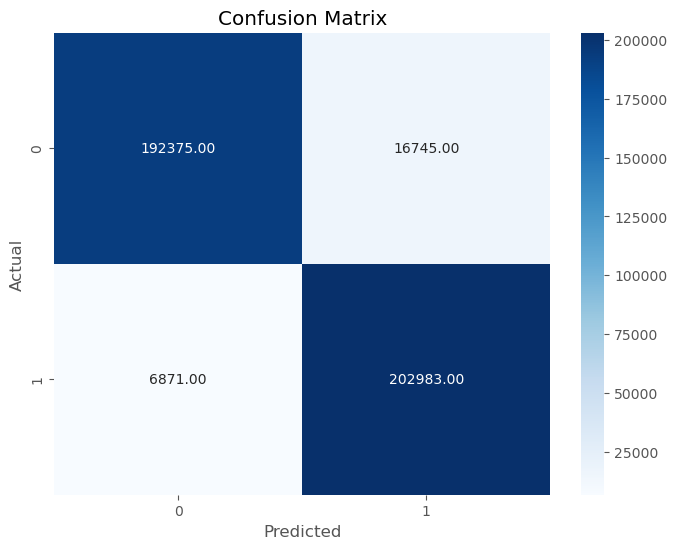

Accuracy: 0.9436337338355124
Classification Report:
               precision    recall  f1-score   support

           0       0.97      0.92      0.94    209120
           1       0.92      0.97      0.95    209854

    accuracy                           0.94    418974
   macro avg       0.94      0.94      0.94    418974
weighted avg       0.94      0.94      0.94    418974

Confusion Matrix:
 [[192375  16745]
 [  6871 202983]]


In [43]:
# Instantiate and fit the Logistic Regression model
logreg = LogisticRegression()
logreg.fit(x_train, y_train)

# Evaluate the Logistic Regression model
metrics = evaluate_model(logreg, x_test, y_test)

# Print the evaluation metrics
print('Accuracy:', metrics['accuracy'])
print('Classification Report:\n', metrics['classification_report'])
print('Confusion Matrix:\n', metrics['confusion_matrix'])


In [44]:
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier

from sklearn.metrics import classification_report, confusion_matrix, roc_auc_score
from sklearn import metrics

# for hyperparameter tuning using k-fold cross validation
from sklearn.model_selection import cross_val_score, cross_val_predict

In [45]:
# x_train, x_test, y_train, y_test

# Scale the feature data using StandardScaler
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()
x_train_scaled = scaler.fit_transform(x_train)
x_test_scaled = scaler.transform(x_test)

# Fit the Logistic Regression model
lr_model = LogisticRegression()
lr_model.fit(x_train_scaled, y_train)

# Make predictions on the test data
lr_probs = lr_model.predict_proba(x_test_scaled)[:, 1]


In [46]:
pip install scikit-learn


Note: you may need to restart the kernel to use updated packages.


In [47]:
from sklearn.metrics import accuracy_score
# create predictions
y_pred = lr_model.predict(x_test_scaled)

# print accuracy score for Logistic Regression
print(f'The accuracy of the logistic regression is {accuracy_score(y_pred, y_test).round(3)*100} ' + '%')

The accuracy of the logistic regression is 91.9 %


In [48]:
#running individual model
Lr = LogisticRegression()
Lr.fit(x_train, y_train)
#checking the score for LR
Lr.score(x_test, y_test)

0.9436337338355124

In [49]:
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score

def metrics_calculator(y_true, y_pred, model_name):
    '''
    Calculates and return a dictionary of performance metrics for a binary classification model
    '''
    # Calculate performance metrics
    accuracy = accuracy_score(y_true, y_pred)
    precision = precision_score(y_true, y_pred)
    recall = recall_score(y_true, y_pred)
    f1 = f1_score(y_true, y_pred)

    # Create a dictionary of results
    results = {'Model': model_name, 'Accuracy': accuracy, 'Precision': precision, 'Recall': recall, 'F1-Score': f1}
    return results

lr_result = metrics_calculator(y_test, y_pred, 'lr_model')
lr_result

{'Model': 'lr_model',
 'Accuracy': 0.918689465217412,
 'Precision': 0.9593600886384898,
 'Recall': 0.8747176608499242,
 'F1-Score': 0.915085756730551}

### Random Forest Model

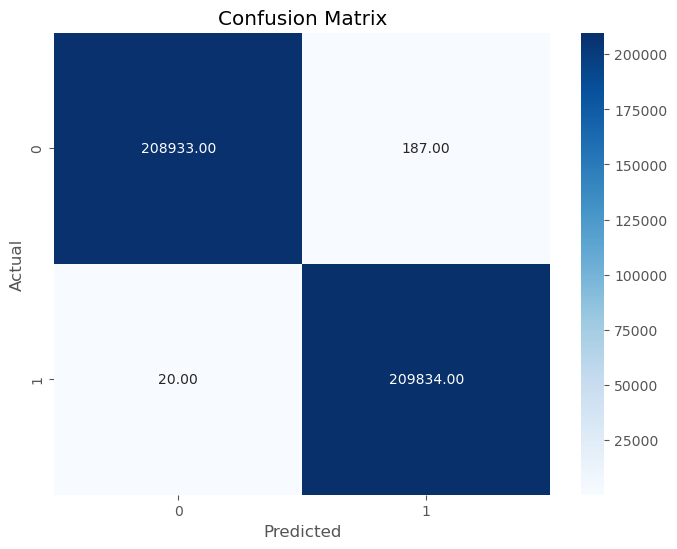

Accuracy: 0.9995059359291985
Classification Report:
               precision    recall  f1-score   support

           0       1.00      1.00      1.00    209120
           1       1.00      1.00      1.00    209854

    accuracy                           1.00    418974
   macro avg       1.00      1.00      1.00    418974
weighted avg       1.00      1.00      1.00    418974

Confusion Matrix:
 [[208933    187]
 [    20 209834]]


In [50]:
# Instantiate the Random Forest Classifier
rf = RandomForestClassifier(n_estimators=100, random_state=42)

# Train the model
rf.fit(x_train, y_train)

# Evaluate the model
metrics = evaluate_model(rf, x_test, y_test)

# Print the evaluation metrics
print('Accuracy:', metrics['accuracy'])
print('Classification Report:\n', metrics['classification_report'])
print('Confusion Matrix:\n', metrics['confusion_matrix'])


In [51]:
#Random forest classifier
RF = RandomForestClassifier(n_estimators = 40)
RF.fit(x_train, y_train)
RF.score(x_test, y_test) 

0.9994844548826419

In [52]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score


In [53]:
# Train the random forest model
rf_model = RandomForestClassifier(random_state=42)
rf_model.fit(x_train, y_train)

RandomForestClassifier(random_state=42)

In [54]:
# Make predictions on the test set
y_pred = rf_model.predict(x_test)

In [55]:
# Calculate the accuracy score
accuracy = accuracy_score(y_test, y_pred)
print(f'The accuracy of the random forest is {accuracy.round(3)*100}%')

The accuracy of the random forest is 100.0%


In [56]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score

def metrics_calculator(y_true, y_pred, model_name):
    '''
    Calculates and return a dictionary of performance metrics for a binary classification model
    '''
    # Calculate performance metrics
    accuracy = accuracy_score(y_true, y_pred)
    precision = precision_score(y_true, y_pred)
    recall = recall_score(y_true, y_pred)
    f1 = f1_score(y_true, y_pred)

    # Create a dictionary of results
    results = {'Model': model_name, 'Accuracy': accuracy, 'Precision': precision, 'Recall': recall, 'F1-Score': f1}
    return results



rf_result = metrics_calculator(y_test, y_pred, 'Random Forest')
print(rf_result)


{'Model': 'Random Forest', 'Accuracy': 0.9995059359291985, 'Precision': 0.999109612848239, 'Recall': 0.9999046956455441, 'F1-Score': 0.9995069961298005}


### Decision Tree

In [86]:
# Create an instance of DecisionTreeClassifier
dt_model = DecisionTreeClassifier()

# Fit the model on the scaled training
dt_model.fit(x_train_scaled, y_train)
dt_probs = dt_model.predict_proba(x_test_scaled)[:, 1]

In [87]:
# Predict the classes of the testing data
y_pred = dt_model.predict(x_test_scaled)

# print accuracy score for DecisionTree Classifier
print(f'The accuracy of the DecisionTree is {accuracy_score(y_pred, y_test).round(3)*100} ' + '%')

The accuracy of the DecisionTree is 100.0 %


In [88]:
dt_result = metrics_calculator(y_test, y_pred, 'dt_model')
dt_result


{'Model': 'dt_model',
 'Accuracy': 0.999634822208538,
 'Precision': 0.9994664761224247,
 'Recall': 0.9998046260733653,
 'F1-Score': 0.9996355225011256}

In [91]:
# Create an instance of K-Nearest Neighbour
knn_model = KNeighborsClassifier()

# Fit the model on the scaled training
knn_model.fit(x_train_scaled, y_train)
knn_probs = knn_model.predict_proba(x_test_scaled)[:, 1]

In [92]:
# Predict the classes of the testing data
y_pred = knn_model.predict(x_test_scaled)

# print accuracy score for K-Nearest Neigbour
print(f'The accuracy of the KNN is {accuracy_score(y_pred, y_test).round(3)*100} ' + '%')

The accuracy of the KNN is 99.4 %


In [94]:
knn_result = metrics_calculator(y_test, y_pred, 'knn_model')
knn_result

{'Model': 'knn_model',
 'Accuracy': 0.9935795538625308,
 'Precision': 0.9883501645403713,
 'Recall': 0.9989564173187073,
 'F1-Score': 0.9936249881505357}

In [95]:
# Concatenate results into a single dataframe all the model metric calculator results
results_df = pd.DataFrame([lr_result, rf_result, dt_result, knn_result])

results_df

,Model,Accuracy,Precision,Recall,F1-Score
0,lr_model,0.918689,0.959360,0.874718,0.915086
1,Random Forest,0.999506,0.999110,0.999905,0.999507
2,dt_model,0.999635,0.999466,0.999805,0.999636
3,knn_model,0.993580,0.988350,0.998956,0.993625


### Feature Engineering

In [63]:
# Feature importances using Random Forest
from sklearn.ensemble import RandomForestClassifier

# Create a Random Forest classifier object
rf_classifier = RandomForestClassifier()

# Fit the classifier to your training data
rf_classifier.fit(x_train_scaled, y_train)

# Get feature importances from the trained classifier
feature_importances = rf_classifier.feature_importances_

# Display feature importances alongside feature names
feature_names = x.columns
feature_importances_dict = dict(zip(feature_names, feature_importances))
sorted_feature_importance = sorted(feature_importances_dict.items(), key=lambda x: x[1], reverse=True)


for feature, importance in sorted_feature_importance:
    print(f'{feature}: {importance:.2f}')

oldbalanceOrg: 0.25
step: 0.19
newbalanceOrig: 0.18
amount: 0.13
type: 0.13
newbalanceDest: 0.06
oldbalanceDest: 0.05


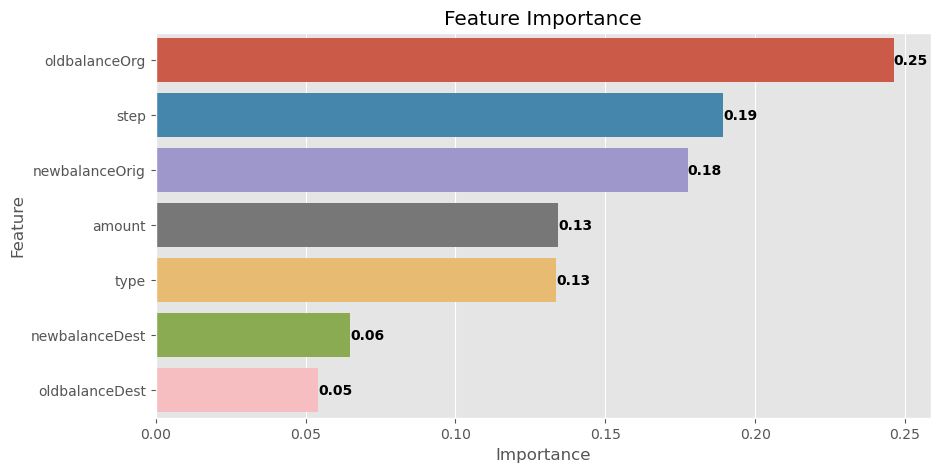

In [64]:
# Create a DataFrame to store feature names and their importances
feature_importance_df = pd.DataFrame({'Feature': feature_names, 'Importance': feature_importances})

# Sort features by importance in descending order
feature_importance_df = feature_importance_df.sort_values(by='Importance', ascending=False)

# Plot the feature importances as a bar chart
plt.figure(figsize=(10, 5))
ax = sns.barplot(x='Importance', y='Feature', data=feature_importance_df)
plt.xlabel('Importance')
plt.ylabel('Feature')
plt.title('Feature Importance')

# Annotate the bars with the importance values
for i, v in enumerate(feature_importance_df['Importance']):
    ax.text(v, i, f'{v:.2f}', color='black', va='center', fontsize=10, fontweight='bold')

plt.show()

## A Bit of Features Selection

In [65]:
# split into training and validation set using 30-70 split ratio
x_train, x_valid, y_train, y_valid = train_test_split(x_resampled, y_resampled, test_size=0.3)

x_train2 = x_train[['oldbalanceOrg', 'step', 'newbalanceOrig', 'type', 'amount', 'oldbalanceDest', 'newbalanceDest']]
x_valid2 = x_valid[['oldbalanceOrg', 'step', 'newbalanceOrig', 'type', 'amount', 'oldbalanceDest', 'newbalanceDest']]

In [66]:
# Since Random Forest model is the best performing model

# fit the model on the new training set
rf_model.fit(x_train2, y_train)

# predit on the new testing set
y_valid2_pred = rf_model.predict(x_valid2)

In [67]:
from sklearn.metrics import accuracy_score
accuracy = accuracy_score(y_valid2_pred, y_valid)
print(f'Accuracy Score: {accuracy:.2f}')

Accuracy Score: 1.00


In [68]:
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score

# Calculate accuracy
accuracy = accuracy_score(y_valid2_pred, y_valid)
print(f'Accuracy Score: {accuracy:.2f}')

# Calculate precision
precision = precision_score(y_valid2_pred, y_valid)
print(f'Precision Score: {precision:.2f}')

# Calculate recall
recall = recall_score(y_valid2_pred, y_valid)
print(f'Recall Score: {recall:.2f}')

# Calculate F1-score
f1 = f1_score(y_valid2_pred, y_valid)
print(f'F1-score: {f1:.2f}')

Accuracy Score: 1.00
Precision Score: 1.00
Recall Score: 1.00
F1-score: 1.00


## Saving the base line model using Pickle
- In Python, the pickle module is used for serializing and deserializing objects. Serialization is the process of converting a Python object into a byte stream, and deserialization is the reverse process of reconstructing the Python object from the byte stream.

In [74]:
# Saving the Model
import pickle
pickle_out = open('classifier.pkl', mode = 'wb')
pickle.dump(rf_model, pickle_out)
pickle_out.close()

In [80]:
filename = "Online_Bank_Fraud_Detection.sav"
pickle.dump(Lr, open(filename, "wb"))

In [81]:
#loading the saved model
loaded_model = pickle.load(open("Online_Bank_Fraud_Detection.sav", "rb"))

## Model Deployment of Online Banking Fraud Detection Model using Streamlit
- We will start with the basic installations:

In [76]:
!pip install -q pyngrok

!pip install -q streamlit

!pip install -q streamlit_ace

In [78]:
%%writefile app.py

import pickle
import streamlit as st

#loading the trained model
pickle_in = open('Classifier.pkl', 'rb')
classifier = pickle.load(pickle_in)

@st.cache()

def predict(model , input_df):
    prediction_df= predict_model(estimator=saved_rf , data = input_df)
    prediction = prediction_df['Label'][0]
    return prediction


def run():
    st.sidebar.image("Untitled.png",caption='Hornorsanya')
    st.title("Online Payments Fraud Detection system")
    st.sidebar.subheader('Under the Supervision of Hornorsanya ')
    get= st.selectbox("Type",['CASH_OUT','CASH_IN','PAYMENT', 'TRANSFER','DEBIT'])
    if get == 'CASH_OUT':
        Type = 1
    if get == 'CASH_IN':
        Type = 2
    if get == 'PAYMENT':
        Type = 3
    if get == 'TRANSFER':
        Type = 4
    if get == 'DEBIT':
        Type = 5
    amount = st.number_input("Amount" )
    oldbalanceOrg= st.number_input("Initial balance before the transaction" , value= 1)
    newbalanceOrig= st.number_input("Customer's balance after the transaction" , value= 1)
    output = ""
    input_dict = {'type': Type , 'amount': amount , 'oldbalanceOrg':oldbalanceOrg,'newbalanceOrig':newbalanceOrig}
    input_df=pd.DataFrame([input_dict])
    st.sidebar.bar_chart(input_df)

    if st.button('Predict'):
        output=predict(model=saved_rf , input_df= input_df)
        if output == 1:
            output='You do a Fraud Transaction'
        if output == 0:
            output = 'Your Transaction is Not Fraud'



    st.success(output)

run()


Overwriting app.py
